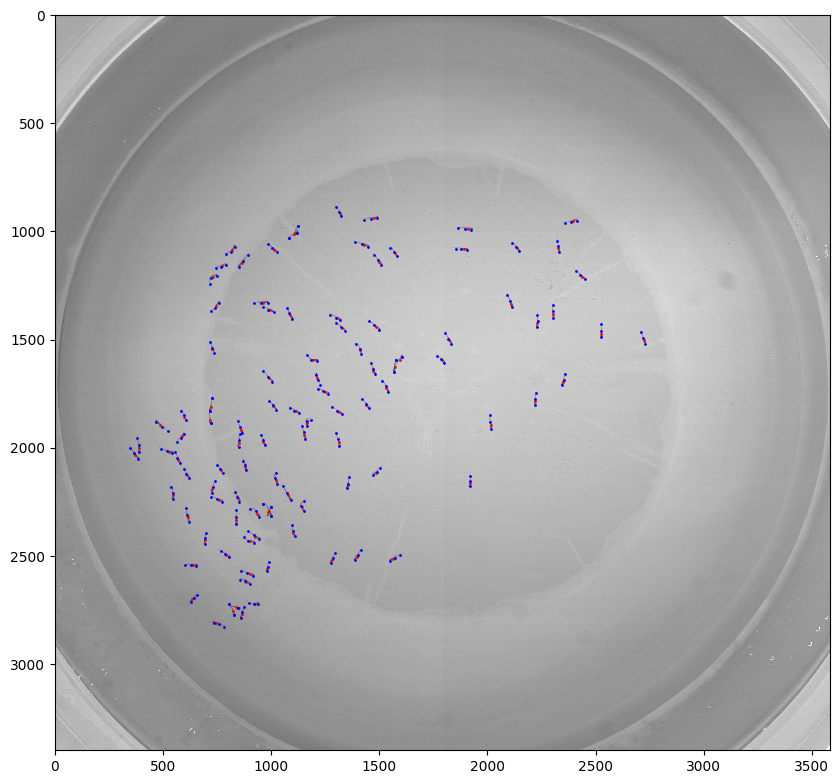

In [1]:
import numpy as np
import matplotlib.pyplot as plt
#Plot the animation
from matplotlib.animation import FuncAnimation
pos=np.load('data_npy/100_2.npy')
vid=np.load('data_video/100_2.npy')
midline=np.load('data_midline/100_2_consistent.npy')
#3584*3400
fig, ax = plt.subplots(figsize=(10, 10))
plt.plot(pos[0,:,0], pos[0,:,1], 'o', color='red', markersize=1)
plt.plot(midline[0,:,0,0], midline[0,:,0,1], 'o', color='blue', markersize=1)
plt.plot(midline[0,:,1,0], midline[0,:,1,1], 'o', color='blue', markersize=1)
plt.plot(midline[0,:,2,0], midline[0,:,2,1], 'o', color='blue', markersize=1)
plt.imshow(vid, interpolation='nearest')

In [2]:
velocity =midline[1:,:,1,:]-midline[:-1,:,1,:]
head=midline[:,:,0,:]-midline[:,:,1,:]
tail=midline[:,:,2,:]-midline[:,:,1,:]
phi= np.arctan2(head[:,:,1], head[:,:,0])
def angle_between_2vec(vec1, vec2, axis=2):
    """Calculate the angle between two vectors."""
    return np.arctan2(
        np.cross(vec1, vec2, axis=axis),
        np.sum(vec1 * vec2, axis=axis)
    )
theta=angle_between_2vec(head, tail, axis=2)
L1=np.linalg.norm(head, axis=2)
L2=np.linalg.norm(tail, axis=2)
Observer_index=0
R=500
Observed_vector=midline[:,None,:,1,:]-midline[:,:,None,1,:]
Observed_distance=np.linalg.norm(Observed_vector, axis=3)
Observed_phi=angle_between_2vec(head[:,:,None,:], Observed_vector, axis=3)
Observed_index=Observed_distance<=R

/var/folders/tl/zpq4sgj12s7fy92kwxb81ndc0000gn/T/ipykernel_56380/939665312.py:8: DeprecationWarning: Arrays of 2-dimensional vectors are deprecated. Use arrays of 3-dimensional vectors instead. (deprecated in NumPy 2.0)
  np.cross(vec1, vec2, axis=axis),


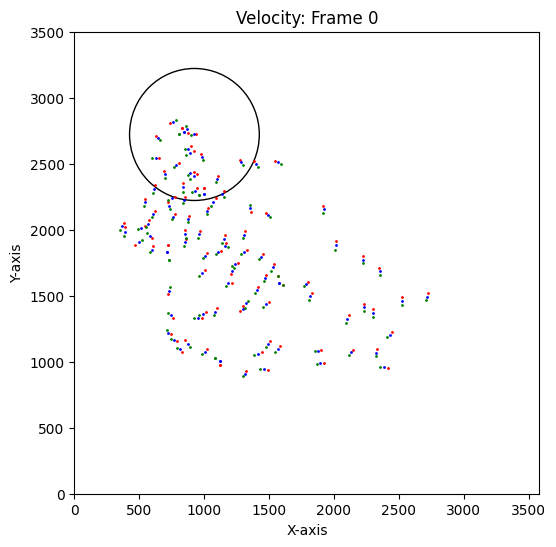

In [3]:
fig, ax = plt.subplots(figsize=(6, 6))
def animate(i):
    ax.clear()
    plt.plot(midline[i,:,0,0], midline[i,:,0,1], 'o', color='red', markersize=1)
    plt.plot(midline[i,:,1,0], midline[i,:,1,1], 'o', color='blue', markersize=1)
    plt.plot(midline[i,:,2,0], midline[i,:,2,1], 'o', color='green', markersize=1)
    circle = plt.Circle((pos[i,0,0], pos[i,0,1]), R, color='black', fill=False)
    ax.add_artist(circle)
    ax.set_xlim(0, 3584)
    ax.set_ylim(0, 3500)
    ax.set_title(f"Velocity: Frame {i}")
    ax.set_xlabel('X-axis')
    ax.set_ylabel('Y-axis')
ani = FuncAnimation(fig, animate, frames=100, repeat=False)
# Show the animation as html
from IPython.display import HTML
HTML(ani.to_jshtml())

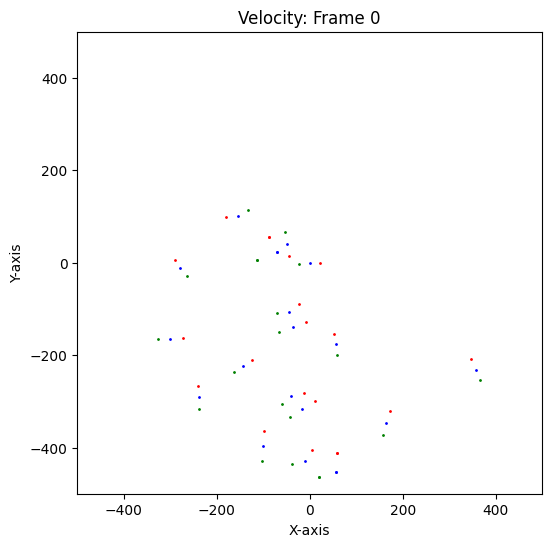

In [4]:
fig, ax = plt.subplots(figsize=(6, 6))

def animate(i):
    ax.clear()
    Each_obs_index=Observed_index[i,Observer_index]
    CM_x=Observed_distance[i,Observer_index,Each_obs_index]*np.cos(Observed_phi[i,Observer_index,Each_obs_index])
    CM_y=Observed_distance[i,Observer_index,Each_obs_index]*np.sin(Observed_phi[i,Observer_index,Each_obs_index])
    ax.plot(L1[i,Each_obs_index]*np.cos(phi[i,Each_obs_index]-phi[i,Observer_index])+CM_x, \
            L1[i,Each_obs_index]*np.sin(phi[i,Each_obs_index]-phi[i,Observer_index])+CM_y, \
                'o', color='red', markersize=1)
    ax.plot(CM_x,CM_y, \
                'o', color='blue', markersize=1)
    ax.plot(L2[i,Each_obs_index]*np.cos(phi[i,Each_obs_index]+theta[i,Each_obs_index]-phi[i,Observer_index])+CM_x, \
            L2[i,Each_obs_index]*np.sin(phi[i,Each_obs_index]+theta[i,Each_obs_index]-phi[i,Observer_index])+CM_y, 'o', color='green', markersize=1)
    ax.set_xlim(-R, R)
    ax.set_ylim(-R, R)
    ax.set_title(f"Velocity: Frame {i}")
    ax.set_xlabel('X-axis')
    ax.set_ylabel('Y-axis')
ani = FuncAnimation(fig, animate, frames=100, repeat=False)
# Show the animation as html
from IPython.display import HTML
HTML(ani.to_jshtml())

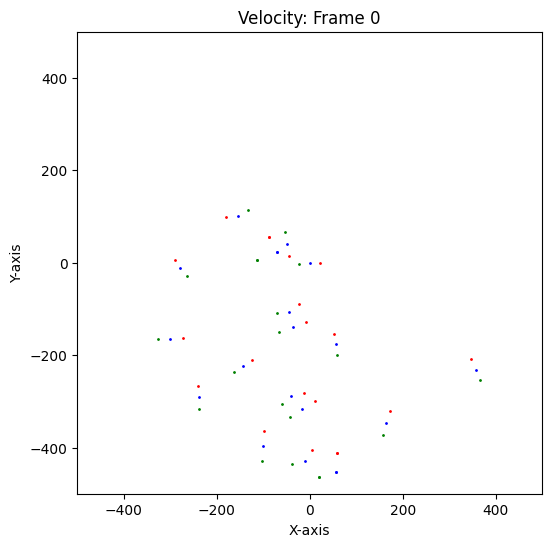

In [5]:
fig, ax = plt.subplots(figsize=(6, 6))

def animate(i):
    ax.clear()
    Each_obs_index=Observed_index[i,Observer_index]
    CM_x=Observed_distance[i,Observer_index,Each_obs_index]*np.cos(Observed_phi[i,Observer_index,Each_obs_index])
    CM_y=Observed_distance[i,Observer_index,Each_obs_index]*np.sin(Observed_phi[i,Observer_index,Each_obs_index])
    ax.plot(L1[i,Each_obs_index]*np.cos(phi[i,Each_obs_index]-phi[i,Observer_index])+CM_x, \
            L1[i,Each_obs_index]*np.sin(phi[i,Each_obs_index]-phi[i,Observer_index])+CM_y, \
                'o', color='red', markersize=1)
    ax.plot(CM_x,CM_y, \
                'o', color='blue', markersize=1)
    ax.plot(L2[i,Each_obs_index]*np.cos(phi[i,Each_obs_index]+theta[i,Each_obs_index]-phi[i,Observer_index])+CM_x, \
            L2[i,Each_obs_index]*np.sin(phi[i,Each_obs_index]+theta[i,Each_obs_index]-phi[i,Observer_index])+CM_y, 'o', color='green', markersize=1)
    ax.set_xlim(-R, R)
    ax.set_ylim(-R, R)
    ax.set_title(f"Velocity: Frame {i}")
    ax.set_xlabel('X-axis')
    ax.set_ylabel('Y-axis')
ani = FuncAnimation(fig, animate, frames=100, repeat=False)
# Show the animation as html
from IPython.display import HTML
HTML(ani.to_jshtml())

In [6]:
R=500
vision_index=np.linalg.norm(midline[:,:,None,1,:],axis=3)<=R
num_observed= np.sum(vision_index, axis=2)

In [7]:
print(num_observed.shape)

(19612, 100)


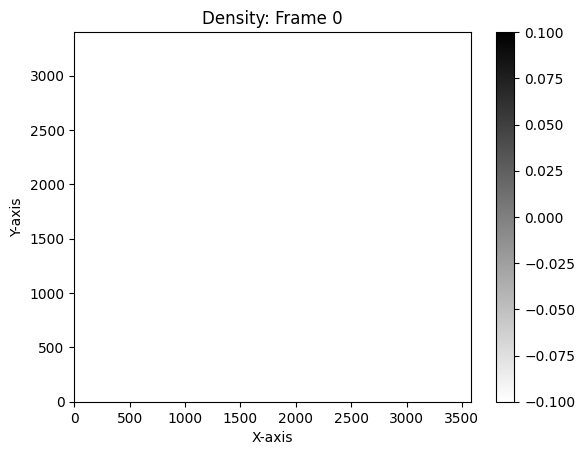

In [8]:
from matplotlib import cm
fig, ax = plt.subplots()
cs=ax.scatter(pos[0,:,0],pos[0,:,1],c=num_observed[0],cmap='gray_r',vmin=0.,vmax=np.max(num_observed))
fig.colorbar(cs) 
def animate(i):
    ax.clear()
    cs=ax.scatter(pos[i,:,0],pos[i,:,1],c=num_observed[i],cmap='gray_r',vmin=0.,vmax=np.max(num_observed))
    ax.set_xlim(0, 3584)
    ax.set_ylim(0, 3400)
    ax.set_title(f"Density: Frame {i}")
    ax.set_xlabel('X-axis')
    ax.set_ylabel('Y-axis')
ani = FuncAnimation(fig, animate, frames=100, repeat=False)
# Show the animation as html
from IPython.display import HTML
HTML(ani.to_jshtml())

In [9]:
local_mean_velocity=np.sum(velocity[:,:,None]*vision_index[:-1,:,:,None], axis=1)/num_observed[:-1,:,None]

/var/folders/tl/zpq4sgj12s7fy92kwxb81ndc0000gn/T/ipykernel_56380/1238705673.py:1: RuntimeWarning: invalid value encountered in divide
  local_mean_velocity=np.sum(velocity[:,:,None]*vision_index[:-1,:,:,None], axis=1)/num_observed[:-1,:,None]


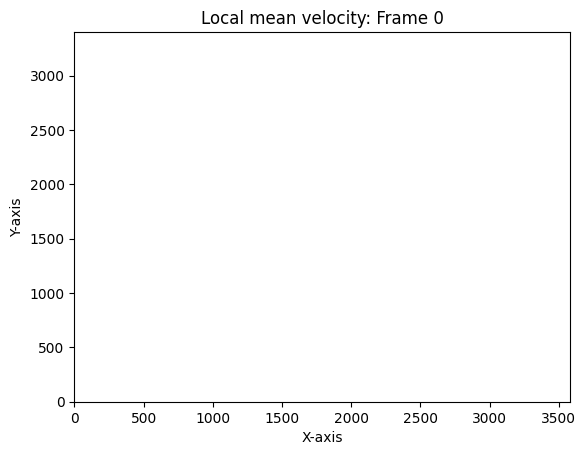

In [10]:
fig, ax = plt.subplots()
def animate(i):
    ax.clear()
    ax.quiver(pos[i,:,0], pos[i,:,1],local_mean_velocity[i,:,0], local_mean_velocity[i,:,1], angles='xy', scale_units='xy', scale=0.1, color='blue')
    ax.set_xlim(0, 3584)
    ax.set_ylim(0, 3400)
    ax.set_title(f"Local mean velocity: Frame {i}")
    ax.set_xlabel('X-axis')
    ax.set_ylabel('Y-axis')
ani = FuncAnimation(fig, animate, frames=100, repeat=False)
# Show the animation as html
from IPython.display import HTML
HTML(ani.to_jshtml())



In [11]:
import numpy as np
from scipy.spatial import cKDTree
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression

def compute_curl(pos, vel, R):
    # pos: shape (N, m, 2) for (x, y) coordinates
    # vel: shape (N, m, 2) for (u, v) velocities
    # R: radius for neighborhood
    N, m = pos.shape[:2]
    
    # Reshape pos and vel to (N*m, 2) for easier processing
    pos_flat = pos.reshape(-1, 2)  # Shape (N*m, 2)
    vel_flat = vel.reshape(-1, 2)  # Shape (N*m, 2)
    
    # Build KDTree for fast neighbor search
    tree = cKDTree(pos_flat)
    
    # Output array for curl
    curl = np.zeros((N, m))
    
    # Polynomial features for linear fit (1, x, y)
    poly = PolynomialFeatures(degree=1)
    
    # Iterate over each point
    for i in range(N):
        for j in range(m):
            # Current point's position
            point = pos[i, j]  # Shape (2,)
            
            # Find indices of points within radius R
            indices = tree.query_ball_point(point, r=R)
            
            if len(indices) < 3:  # Need at least 3 points for a linear fit
                curl[i, j] = np.nan  # Not enough neighbors
                continue
            
            # Get neighboring points and velocities
            neighbors_pos = pos_flat[indices]  # Shape (n_neighbors, 2)
            neighbors_vel = vel_flat[indices]  # Shape (n_neighbors, 2)
            
            # Prepare polynomial features
            X_poly = poly.fit_transform(neighbors_pos)
            
            # Fit linear model for u and v
            u_model = LinearRegression().fit(X_poly, neighbors_vel[:, 0])
            v_model = LinearRegression().fit(X_poly, neighbors_vel[:, 1])
            
            # Coefficients: [const, x, y]
            # ∂u/∂y is the coefficient of y in u_model
            # ∂v/∂x is the coefficient of x in v_model
            du_dy = u_model.coef_[2]  # ∂u/∂y
            dv_dx = v_model.coef_[1]  # ∂v/∂x
            
            # Compute curl: ∂v/∂x - ∂u/∂y
            curl[i, j] = dv_dx - du_dy
    
    return curl

curl = compute_curl(pos[:100], velocity[:100], R)

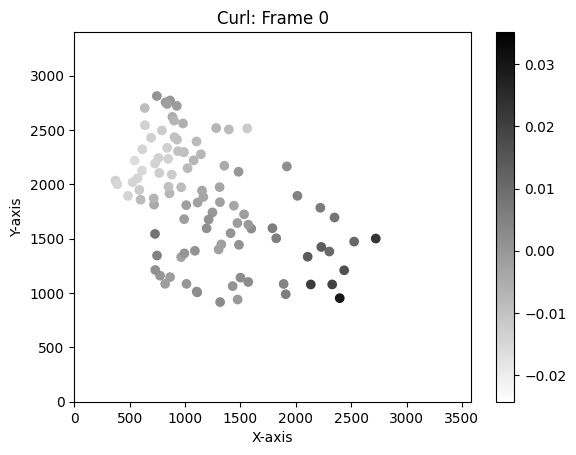

In [12]:
from matplotlib import cm
fig, ax = plt.subplots()
cs=ax.scatter(pos[0,:,0],pos[0,:,1],c=curl[0],cmap='gray_r',vmin=np.min(curl),vmax=np.max(curl))
fig.colorbar(cs) 
def animate(i):
    ax.clear()
    cs=ax.scatter(pos[i,:,0],pos[i,:,1],c=curl[i],cmap='gray_r',vmin=np.min(curl),vmax=np.max(curl))
    ax.set_xlim(0, 3584)
    ax.set_ylim(0, 3400)
    ax.set_title(f"Curl: Frame {i}")
    ax.set_xlabel('X-axis')
    ax.set_ylabel('Y-axis')
ani = FuncAnimation(fig, animate, frames=100, repeat=False)
# Show the animation as html
from IPython.display import HTML
HTML(ani.to_jshtml())